In [82]:
%pip install opencv-python-headless
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os

from pipeline.preprocessing import load_images_from_folder, resize
from pipeline.features import detect_features, anms
from pipeline.matching import match_descriptors, draw_matches
from pipeline.homography_manual import compute_homography_dlt
# from pipeline.utils import select_correspondences, visualize_transformed_points
# from pipeline.utils import draw_matches_ransac
from pipeline.ransac import ransac_homography
from pipeline.stitching import stitch_images_with_blending



[notice] A new release of pip is available: 24.0 -> 25.0.1
[notice] To update, run: python3.10 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [4]:
def show_images(imgs, titles=None, cmap='gray'):
    n = len(imgs)
    plt.figure(figsize=(5 * n, 5))
    for i in range(n):
        img_rgb = cv2.cvtColor(imgs[i], cv2.COLOR_BGR2RGB) if len(imgs[i].shape) == 3 else imgs[i]
        plt.subplot(1, n, i + 1)
        plt.imshow(img_rgb, cmap=cmap)
        if titles:
            plt.title(titles[i])
        plt.axis('off')
    plt.tight_layout()
    plt.show()


## Cargamos las Imágenes

In [5]:

# Cargar todas las imágenes
images_color, images_gray = load_images_from_folder("img", target_width=480)


In [6]:
#separamos las imagenes por conjunto

# Imágenes udesa (son las últimas 3)
img0_udesa, img1_udesa, img2_udesa = images_color[3:6]
gray0_udesa, gray1_udesa, gray2_udesa = images_gray[3:6]

# Imágenes cuadro (son las primeras 3)
img0_cuadro, img1_cuadro, img2_cuadro = images_color[0:3]
gray0_cuadro, gray1_cuadro, gray2_cuadro = images_gray[0:3]


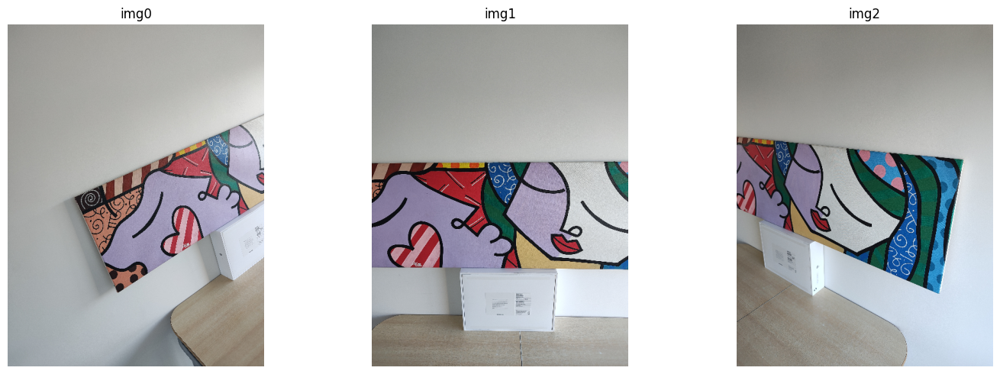

In [7]:
show_images([img0_cuadro, img1_cuadro, img2_cuadro], ['img0', 'img1', 'img2'])


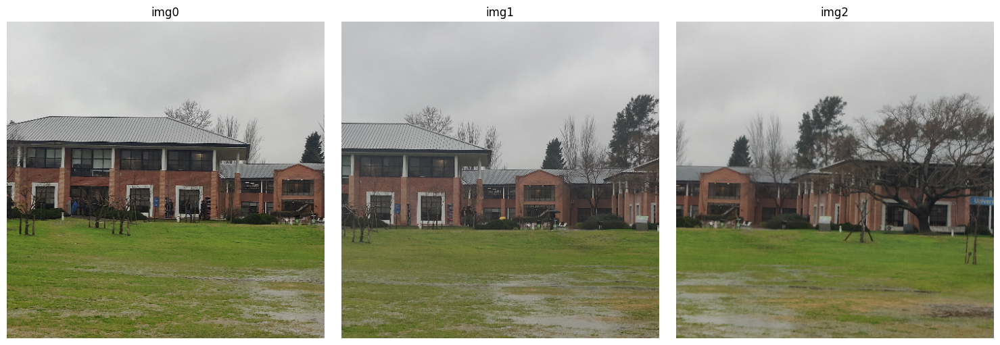

In [8]:
show_images([img0_udesa, img1_udesa, img2_udesa], ['img0', 'img1', 'img2'])


## Detectamos características en ambos conjuntos de imágenes 

In [9]:
# Aplicar detector SIFT + descriptores
kp0_udesa, desc0_udesa = detect_features(gray0_udesa)
kp1_udesa, desc1_udesa = detect_features(gray1_udesa)
kp2_udesa, desc2_udesa = detect_features(gray2_udesa)

kp0_cuadro, desc0_cuadro = detect_features(gray0_cuadro)
kp1_cuadro, desc1_cuadro = detect_features(gray1_cuadro)
kp2_cuadro, desc2_cuadro = detect_features(gray2_cuadro)

# Mostrar cantidad de keypoints
print("img0_udesa:", len(kp0_udesa), "keypoints", desc0_udesa.shape, "descriptors")
print("img1_udesa:", len(kp1_udesa), "keypoints", desc1_udesa.shape, "descriptors")
print("img2_udesa:", len(kp2_udesa), "keypoints", desc2_udesa.shape, "descriptors")

print()

print("img0_cuadro:", len(kp0_cuadro), "keypoints", desc0_cuadro.shape, "descriptors")
print("img1_cuadro:", len(kp1_cuadro), "keypoints", desc1_cuadro.shape, "descriptors")
print("img2_cuadro:", len(kp2_cuadro), "keypoints", desc2_cuadro.shape, "descriptors")


img0_udesa: 649 keypoints (649, 128) descriptors
img1_udesa: 568 keypoints (568, 128) descriptors
img2_udesa: 984 keypoints (984, 128) descriptors

img0_cuadro: 357 keypoints (357, 128) descriptors
img1_cuadro: 343 keypoints (343, 128) descriptors
img2_cuadro: 369 keypoints (369, 128) descriptors


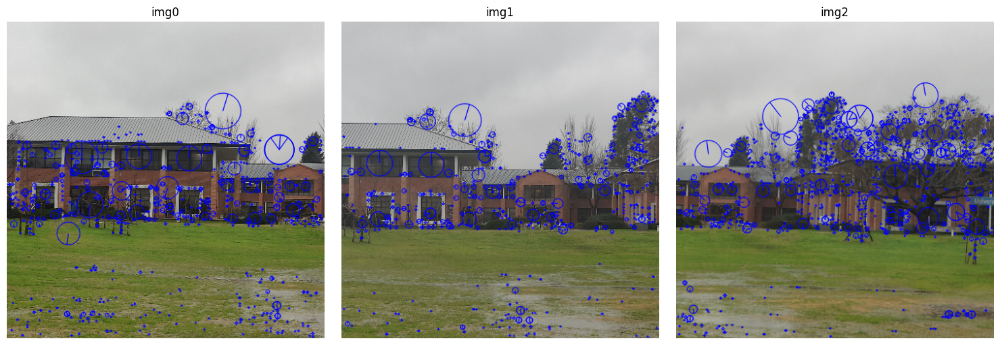

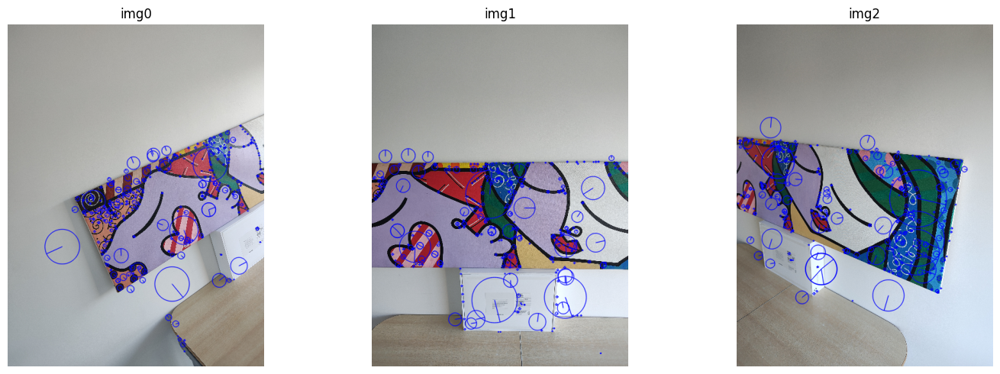

In [10]:
img0_kp_udesa = cv2.drawKeypoints(img0_udesa, kp0_udesa, None, (255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img1_kp_udesa = cv2.drawKeypoints(img1_udesa, kp1_udesa, None, (255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img2_kp_udesa = cv2.drawKeypoints(img2_udesa, kp2_udesa, None, (255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

img0_kp_cuadro = cv2.drawKeypoints(img0_cuadro, kp0_cuadro, None, (255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img1_kp_cuadro = cv2.drawKeypoints(img1_cuadro, kp1_cuadro, None, (255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img2_kp_cuadro = cv2.drawKeypoints(img2_cuadro, kp2_cuadro, None, (255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

show_images([img0_kp_udesa, img1_kp_udesa, img2_kp_udesa], ['img0', 'img1', 'img2'])
show_images([img0_kp_cuadro, img1_kp_cuadro, img2_kp_cuadro], ['img0', 'img1', 'img2'])

## Apilcamos ANMS para obtener los 200 keypoints mejor distribuidos

In [11]:
kp0_udesa, desc0_udesa = anms(kp0_udesa, desc0_udesa, N=200)
kp1_udesa, desc1_udesa = anms(kp1_udesa, desc1_udesa, N=200)
kp2_udesa, desc2_udesa = anms(kp2_udesa, desc2_udesa, N=200)

print("img0_udesa (ANMS):", len(kp0_udesa), "keypoints")
print("img1_udesa (ANMS):", len(kp1_udesa), "keypoints")
print("img2_udesa (ANMS):", len(kp2_udesa), "keypoints")

kp0_cuadro, desc0_cuadro = anms(kp0_cuadro, desc0_cuadro, N=200)
kp1_cuadro, desc1_cuadro = anms(kp1_cuadro, desc1_cuadro, N=200)
kp2_cuadro, desc2_cuadro = anms(kp2_cuadro, desc2_cuadro, N=200)

print("img0_cuadro (ANMS):", len(kp0_cuadro), "keypoints")
print("img1_cuadro (ANMS):", len(kp1_cuadro), "keypoints")
print("img2_cuadro (ANMS):", len(kp2_cuadro), "keypoints")

img0_udesa (ANMS): 200 keypoints
img1_udesa (ANMS): 200 keypoints
img2_udesa (ANMS): 200 keypoints
img0_cuadro (ANMS): 144 keypoints
img1_cuadro (ANMS): 167 keypoints
img2_cuadro (ANMS): 164 keypoints


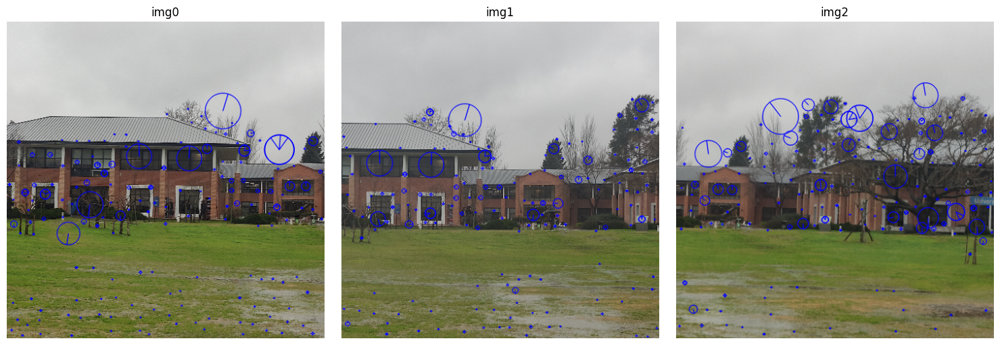

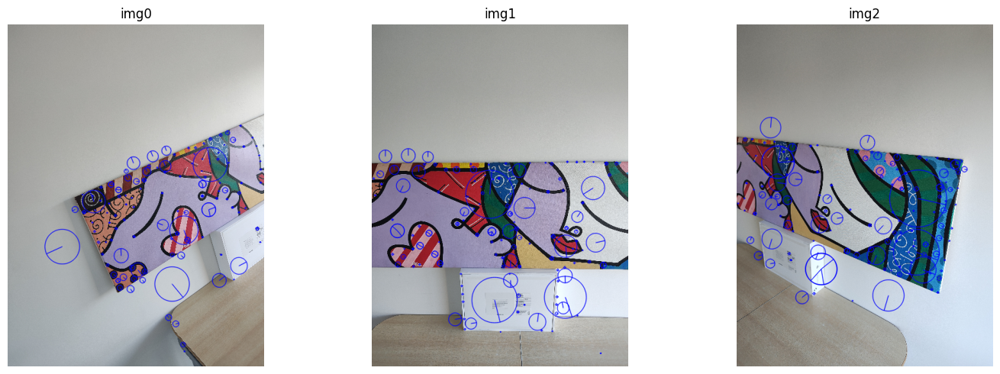

In [12]:
img0_kp_udesa = cv2.drawKeypoints(img0_udesa, kp0_udesa, None, (255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img1_kp_udesa = cv2.drawKeypoints(img1_udesa, kp1_udesa, None, (255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img2_kp_udesa = cv2.drawKeypoints(img2_udesa, kp2_udesa, None, (255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

img0_kp_cuadro = cv2.drawKeypoints(img0_cuadro, kp0_cuadro, None, (255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img1_kp_cuadro = cv2.drawKeypoints(img1_cuadro, kp1_cuadro, None, (255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img2_kp_cuadro = cv2.drawKeypoints(img2_cuadro, kp2_cuadro, None, (255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

show_images([img0_kp_udesa, img1_kp_udesa, img2_kp_udesa], ['img0', 'img1', 'img2'])
show_images([img0_kp_cuadro, img1_kp_cuadro, img2_kp_cuadro], ['img0', 'img1', 'img2'])


## Asociamos las características de las imagenes 0 y 2 con el ancla

* Imagenes 0 y 1

In [13]:
# Realizar el matching usando el ratio test de Lowe
matches_01_udesa = match_descriptors(desc0_udesa, desc1_udesa, method='lowe', ratio_thresh=0.85)

matches_01_cuadro = match_descriptors(desc0_cuadro, desc1_cuadro, method='lowe', ratio_thresh=0.85)

print(f"Total matches entre img0_udesa e img1_udesa (ratio test): {len(matches_01_udesa)}")

print(f"Total matches entre img0_cuadro e img1_cuadro (ratio test): {len(matches_01_cuadro)}")


Total matches entre img0_udesa e img1_udesa (ratio test): 45
Total matches entre img0_cuadro e img1_cuadro (ratio test): 41


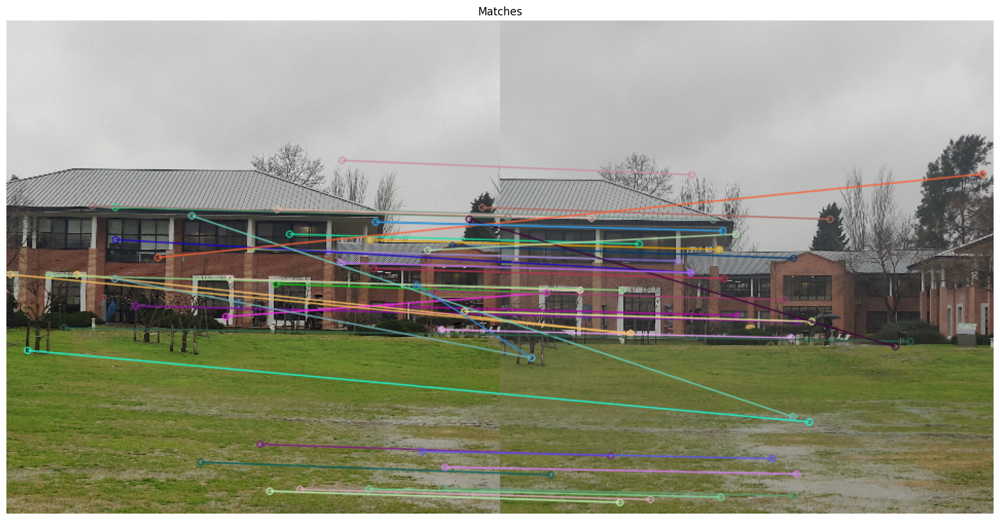

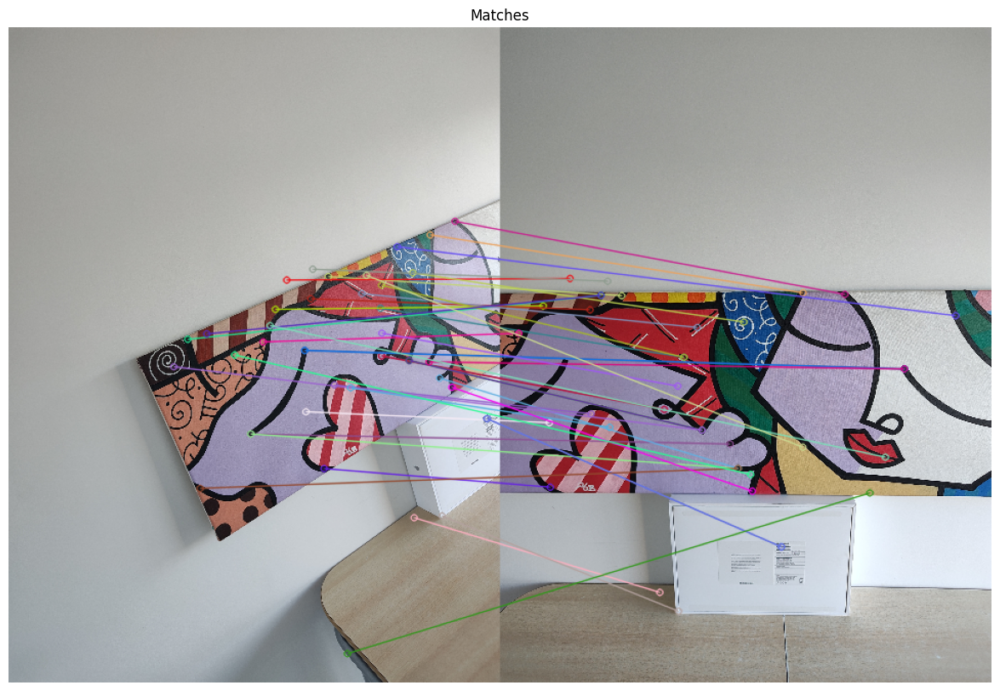

In [14]:
draw_matches(img0_udesa, kp0_udesa, img1_udesa, kp1_udesa, matches_01_udesa)

draw_matches(img0_cuadro, kp0_cuadro, img1_cuadro, kp1_cuadro, matches_01_cuadro)


Probamos con cross check

Total matches con cross-check, imagen udesa: 80


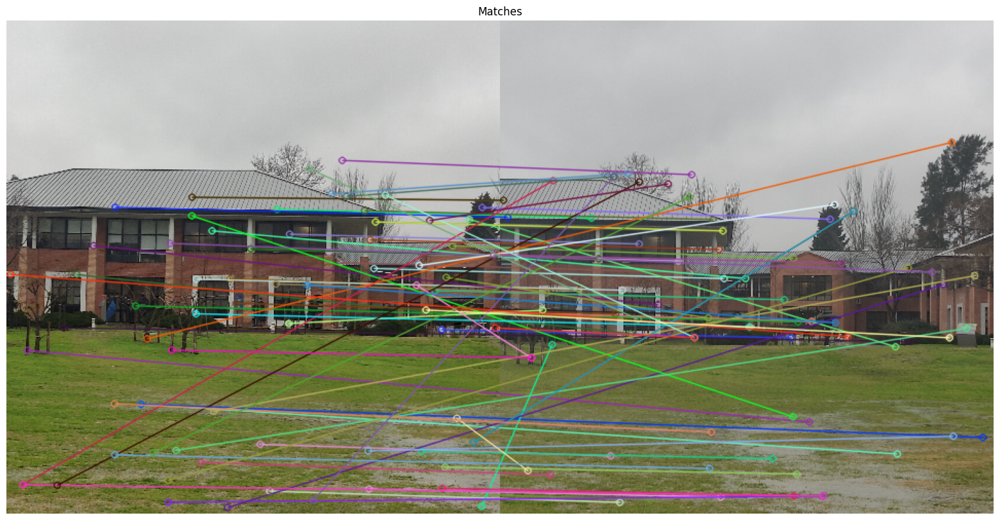

Total matches con cross-check, imagen cuadro: 55


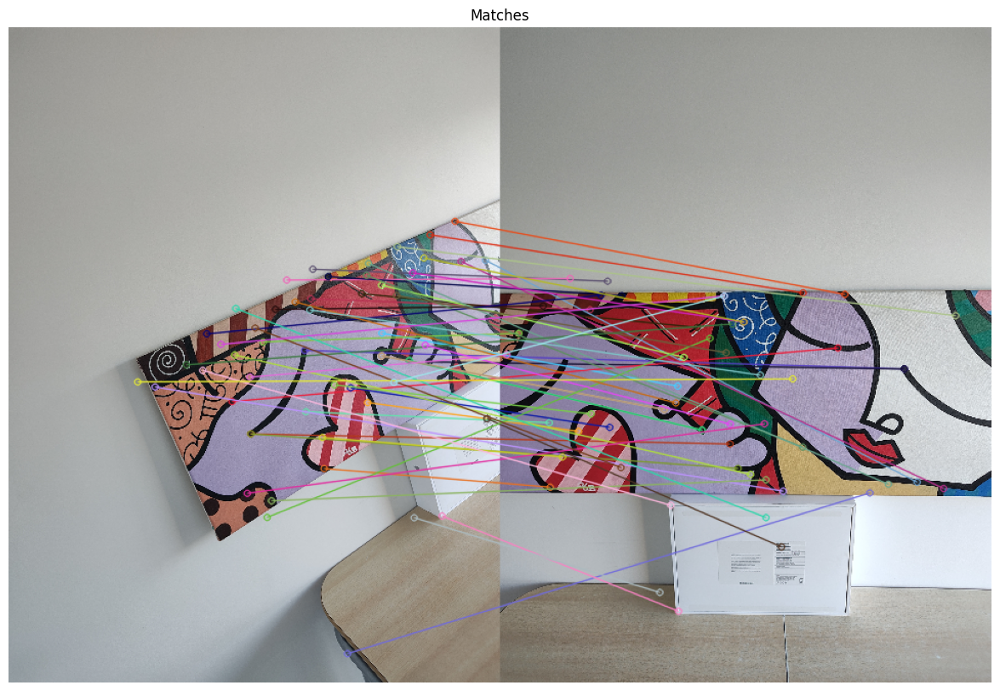

In [15]:
matches_01_cross_udesa = match_descriptors(desc0_udesa, desc1_udesa, method='cross_check')
print(f"Total matches con cross-check, imagen udesa: {len(matches_01_cross_udesa)}")
draw_matches(img0_udesa, kp0_udesa, img1_udesa, kp1_udesa, matches_01_cross_udesa)

matches_01_cross_cuadro = match_descriptors(desc0_cuadro, desc1_cuadro, method='cross_check')
print(f"Total matches con cross-check, imagen cuadro: {len(matches_01_cross_cuadro)}")
draw_matches(img0_cuadro, kp0_cuadro, img1_cuadro, kp1_cuadro, matches_01_cross_cuadro)


* Imagenes 1 y 2

In [16]:
matches_12_udesa = match_descriptors(desc1_udesa, desc2_udesa, method='lowe', ratio_thresh=0.85)
matches_12_cuadro = match_descriptors(desc1_cuadro, desc2_cuadro, method='lowe', ratio_thresh=0.85)

print(f"Total matches entre img1_udesa e img2_udesa (ratio test): {len(matches_12_udesa)}")
print(f"Total matches entre img1_cuadro e img2_cuadro (ratio test): {len(matches_12_cuadro)}")



Total matches entre img1_udesa e img2_udesa (ratio test): 35
Total matches entre img1_cuadro e img2_cuadro (ratio test): 48


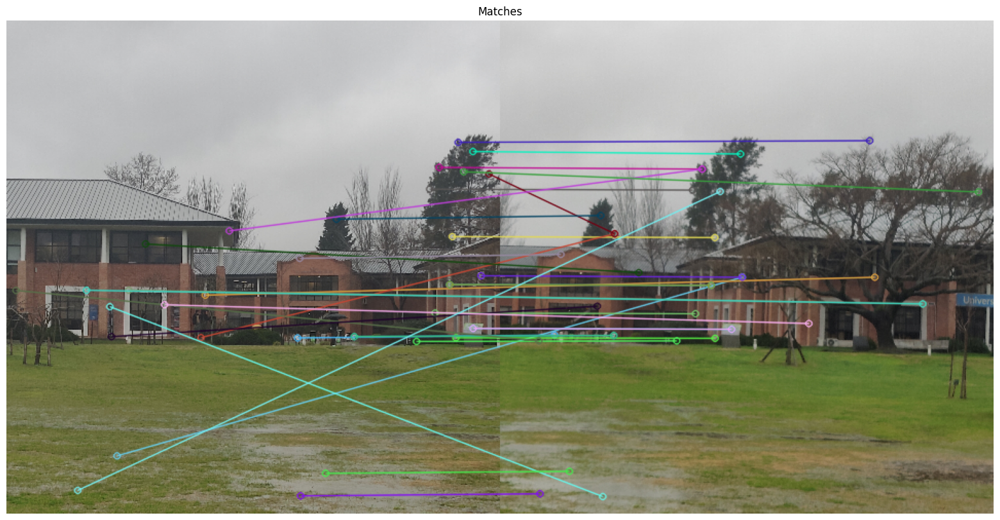

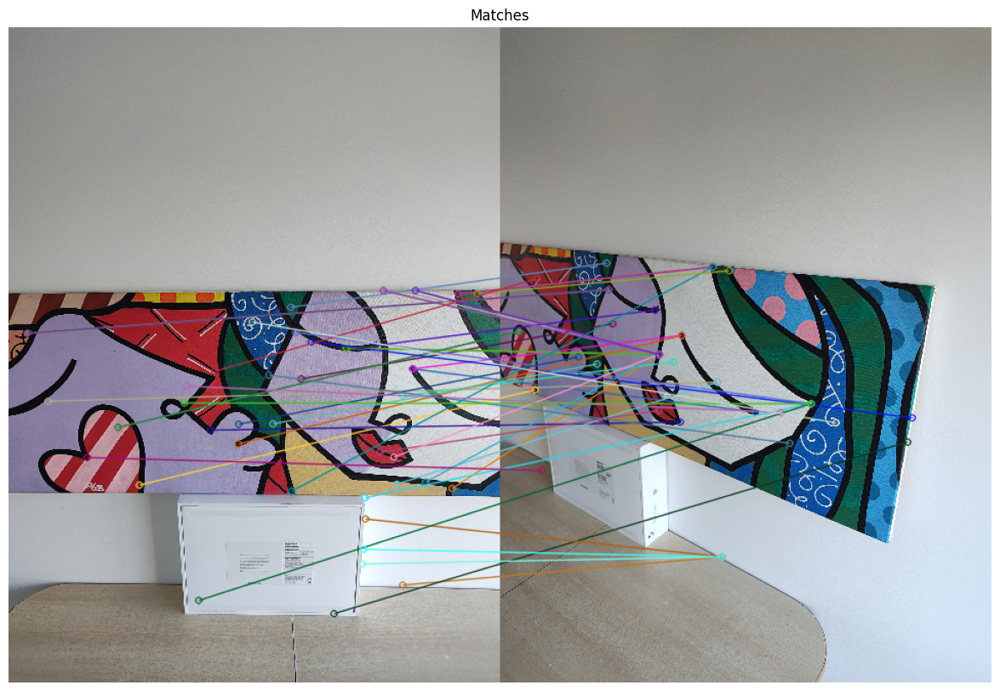

In [17]:
draw_matches(img1_udesa, kp1_udesa, img2_udesa, kp2_udesa, matches_12_udesa)
draw_matches(img1_cuadro, kp1_cuadro, img2_cuadro, kp2_cuadro, matches_12_cuadro)


Probamos con cross check 

Total matches con cross-check, imagen udesa: 72


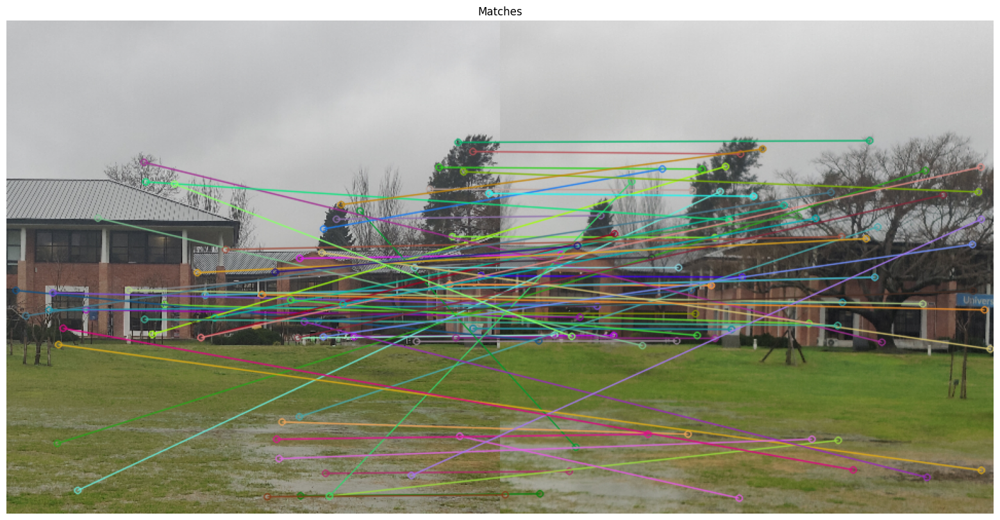

Total matches con cross-check, imagen cuadro: 58


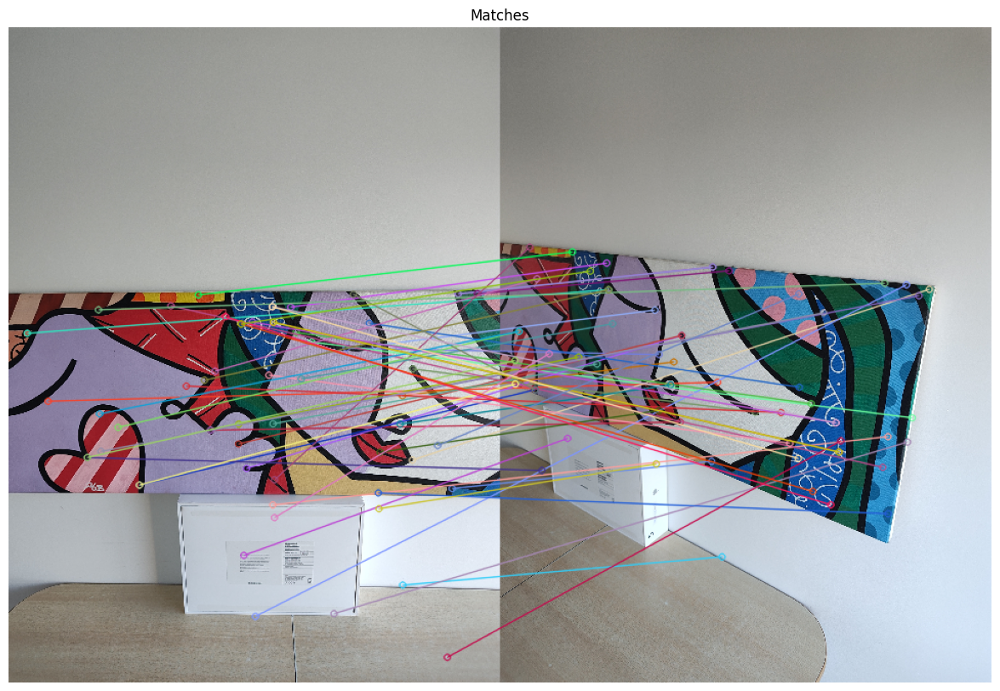

In [18]:
matches_12_cross_udesa = match_descriptors(desc1_udesa, desc2_udesa, method='cross_check')
print(f"Total matches con cross-check, imagen udesa: {len(matches_12_cross_udesa)}")
draw_matches(img1_udesa, kp1_udesa, img2_udesa, kp2_udesa, matches_12_cross_udesa)

matches_12_cross_cuadro = match_descriptors(desc1_cuadro, desc2_cuadro, method='cross_check')
print(f"Total matches con cross-check, imagen cuadro: {len(matches_12_cross_cuadro)}")
draw_matches(img1_cuadro, kp1_cuadro, img2_cuadro, kp2_cuadro, matches_12_cross_cuadro)

## Aplicamos DLT para estimar manualmente una Homografía con 4 puntos correspondientes

* Imagenes 0 y 1

Salida de correr manual_points.py, con udesa_0 y udesa_1

```

Puntos seleccionados en imagen 1: 

    [(298.72077922077926, 262.01082251082255), (349.2835497835498, 313.9588744588745), (447.63852813852816, 314.6515151515152), (367.2922077922078, 364.52164502164504)]

Puntos seleccionados en imagen 2: 

    [(554.9978354978355, 354.1320346320347), (538.3744588744589, 301.49134199134204), (487.8116883116883, 250.23593073593076), (635.3441558441558, 304.2619047619048)]

In [ ]:
points_anchor_udesa = np.array([
    (298.72077922077926, 262.01082251082255),
    (349.2835497835498, 313.9588744588745),
    (447.63852813852816, 314.6515151515152),
    (367.2922077922078, 364.52164502164504)
])

points_target_udesa = np.array([
    (554.9978354978355, 354.1320346320347),
    (538.3744588744589, 301.49134199134204),
    (487.8116883116883, 250.23593073593076),
    (635.3441558441558, 304.2619047619048)
])



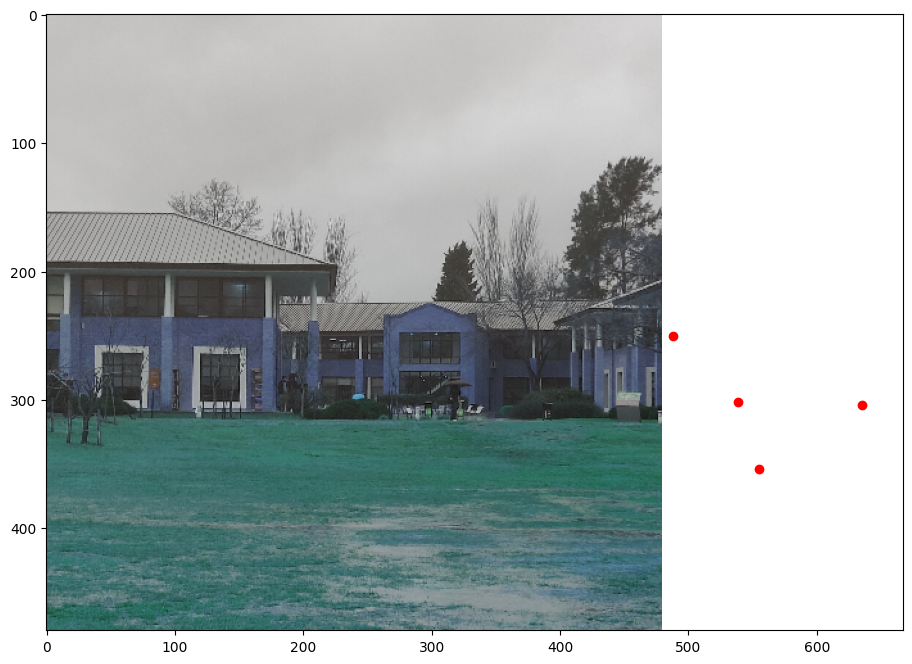

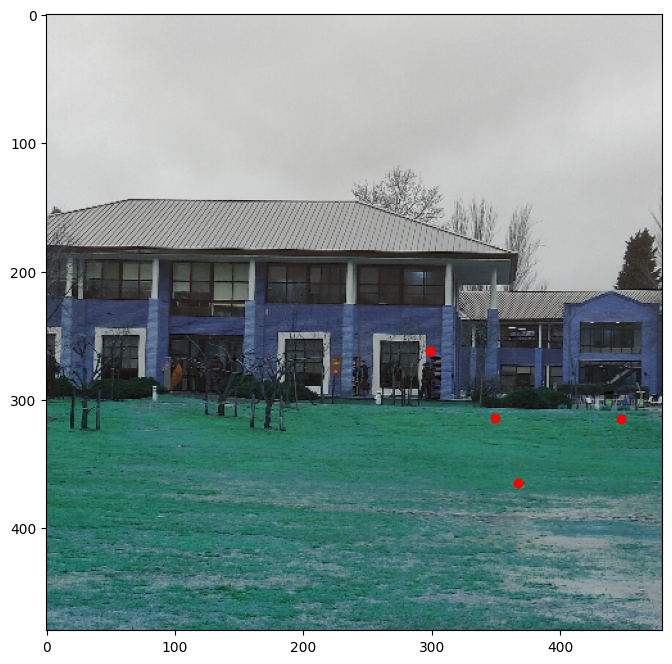

In [21]:
plt.figure(figsize=(12, 8))
plt.imshow(img1_udesa, cmap='gray')
plt.scatter([554.9978354978355, 538.3744588744589, 487.8116883116883, 635.3441558441558], [354.1320346320347, 301.49134199134204, 250.23593073593076, 304.2619047619048], color='red')
plt.show()

plt.figure(figsize=(12, 8))
plt.imshow(img0_udesa, cmap='gray')
plt.scatter([298.72077922077926, 349.2835497835498, 447.63852813852816, 367.2922077922078], [262.01082251082255, 313.9588744588745, 314.6515151515152, 364.52164502164504], color='red')
plt.show()

Salida de correr manual_points.py, con cuadro_0 y cuadro_1

```

Puntos seleccionados en imagen 1: 

    [(85.94047619047626, 436.1547619047618), (459.8203463203464, 625.4025974025974), (331.5010822510824, 475.8506493506493), (101.6341991341992, 559.858225108225)]

Puntos seleccionados en imagen 2: 
    
    [(384.12121212121224, 420.46103896103887), (531.82683982684, 521.0854978354978), (551.2132034632036, 369.68722943722935), (636.1439393939395, 426.0)]

In [60]:
points_anchor_cuadro = np.array([
    (85.94047619047626, 436.1547619047618),
    (459.8203463203464, 625.4025974025974),
    (331.5010822510824, 475.8506493506493),
    (101.6341991341992, 559.858225108225)
])

points_target_cuadro = np.array([
    (384.12121212121224, 420.46103896103887),
    (531.82683982684, 521.0854978354978),
    (551.2132034632036, 369.68722943722935),
    (636.1439393939395, 426.0)
])


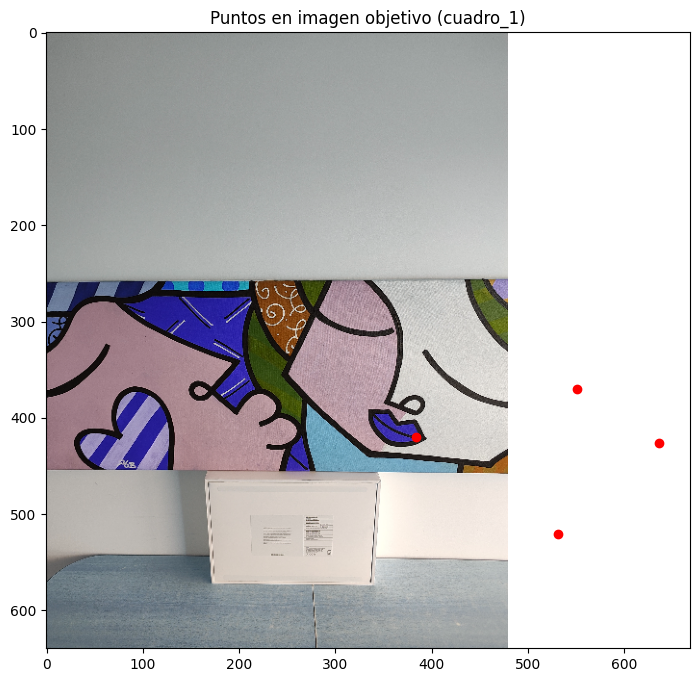

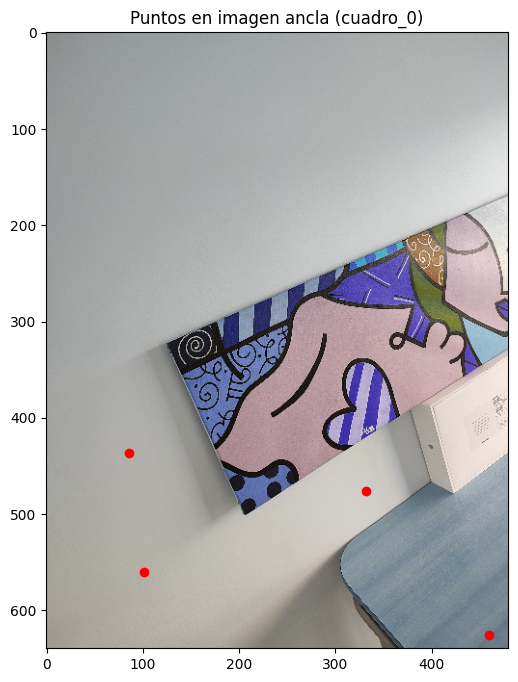

In [61]:
plt.figure(figsize=(12, 8))
plt.imshow(img1_cuadro, cmap='gray')
plt.scatter(points_target_cuadro[:, 0], points_target_cuadro[:, 1], color='red')
plt.title("Puntos en imagen objetivo (cuadro_1)")
plt.show()

plt.figure(figsize=(12, 8))
plt.imshow(img0_cuadro, cmap='gray')
plt.scatter(points_anchor_cuadro[:, 0], points_anchor_cuadro[:, 1], color='red')
plt.title("Puntos en imagen ancla (cuadro_0)")
plt.show()

In [62]:

H_udesa = compute_homography_dlt(points_anchor_udesa, points_target_udesa)
H_cuadro = compute_homography_dlt(points_anchor_cuadro, points_target_cuadro)

print("Homografía estimada H, imagen udesa:")
print(H_udesa)

print()

print("Homografía estimada H, imagen cuadro:")
print(H_cuadro)



Homografía estimada H, imagen udesa:
[[ 9.08034336e-01 -1.18698252e-01  2.22595828e+02]
 [ 1.24952922e-02  8.66935089e-01  4.97504501e+00]
 [-1.55241178e-05 -1.88685737e-04  1.00000000e+00]]

Homografía estimada H, imagen cuadro:
[[ 4.01051550e-01 -1.26932887e+00  5.48591970e+02]
 [ 2.33580820e-01 -9.46693685e-01  4.25050287e+02]
 [ 6.22800221e-04 -2.23978998e-03  1.00000000e+00]]


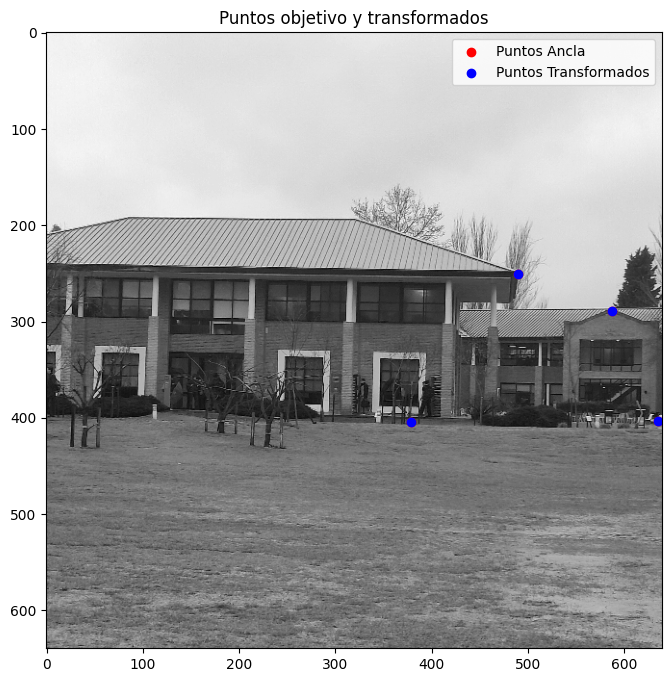

In [63]:
# Pasar puntos a coordenadas homogéneas
pts_anchor_homog = np.hstack([points_anchor_udesa, np.ones((4, 1))])
pts_transformed = (H_udesa @ pts_anchor_homog.T).T
pts_transformed /= pts_transformed[:, 2][:, np.newaxis]  # normalizar

# Mostrar imagen objetivo y superponer puntos
img_target = cv2.imread("img/udesa_0.jpg")
img_target = resize(img_target, 640)
img_target_gray = cv2.cvtColor(img_target, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(10, 8))
plt.imshow(img_target_gray, cmap='gray')
plt.scatter(points_target_udesa[:, 0], points_target_udesa[:, 1], color='red', label='Puntos Ancla')
plt.scatter(pts_transformed[:, 0], pts_transformed[:, 1], color='blue', label='Puntos Transformados')
plt.legend()
plt.title("Puntos objetivo y transformados")
plt.show()


--> los puntos se superponen, el resultado es bueno: lo vemos en dos graficos a continuacion

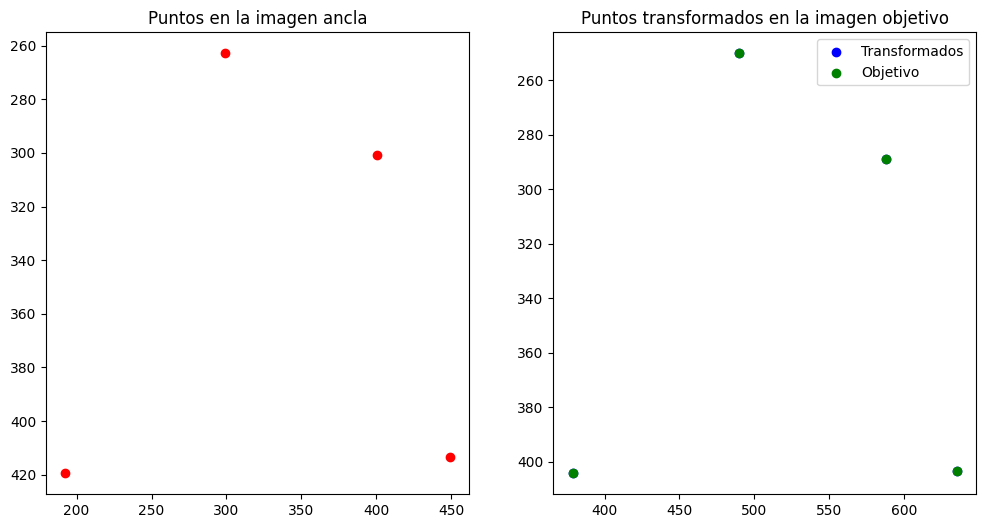

In [64]:
plt.figure(figsize=(12, 6))

# Imagen ancla
plt.subplot(1, 2, 1)
plt.title("Puntos en la imagen ancla")
plt.scatter(points_anchor_udesa[:, 0], points_anchor_udesa[:, 1], color='red')
plt.gca().invert_yaxis()

# Imagen objetivo
plt.subplot(1, 2, 2)
plt.title("Puntos transformados en la imagen objetivo")
plt.scatter(pts_transformed[:, 0], pts_transformed[:, 1], color='blue', label='Transformados')
plt.scatter(points_target_udesa[:, 0], points_target_udesa[:, 1], color='green', label='Objetivo')
plt.legend()
plt.gca().invert_yaxis()

plt.show()


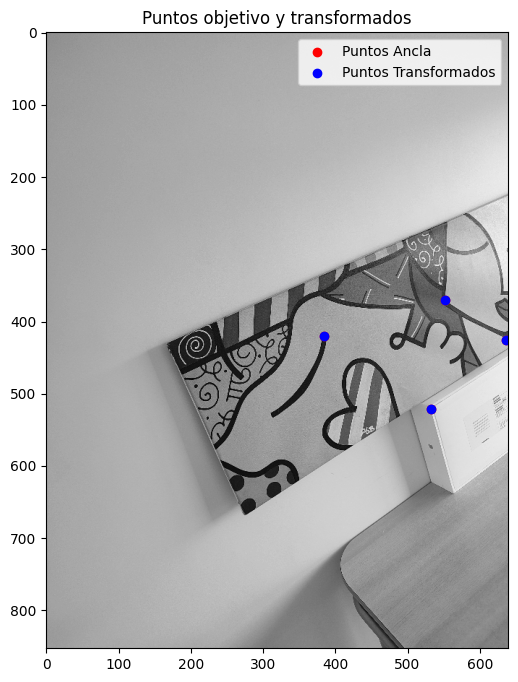

In [65]:
# Pasar puntos a coordenadas homogéneas
pts_anchor_homog = np.hstack([points_anchor_cuadro, np.ones((4, 1))])
pts_transformed = (H_cuadro @ pts_anchor_homog.T).T
pts_transformed /= pts_transformed[:, 2][:, np.newaxis]  # normalizar

# Mostrar imagen objetivo y superponer puntos
img_target = cv2.imread("img/cuadro_0.jpg")
img_target = resize(img_target, 640)
img_target_gray = cv2.cvtColor(img_target, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(10, 8))
plt.imshow(img_target_gray, cmap='gray')
plt.scatter(points_target_cuadro[:, 0], points_target_cuadro[:, 1], color='red', label='Puntos Ancla')
plt.scatter(pts_transformed[:, 0], pts_transformed[:, 1], color='blue', label='Puntos Transformados')
plt.legend()
plt.title("Puntos objetivo y transformados")
plt.show()


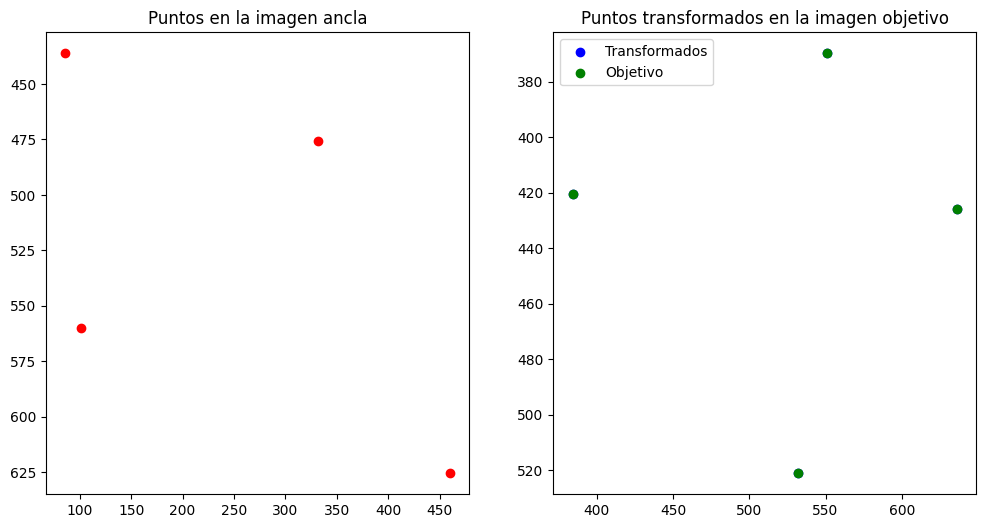

In [66]:
plt.figure(figsize=(12, 6))

# Imagen ancla
plt.subplot(1, 2, 1)
plt.title("Puntos en la imagen ancla")
plt.scatter(points_anchor_cuadro[:, 0], points_anchor_cuadro[:, 1], color='red')
plt.gca().invert_yaxis()

# Imagen objetivo
plt.subplot(1, 2, 2)
plt.title("Puntos transformados en la imagen objetivo")
plt.scatter(pts_transformed[:, 0], pts_transformed[:, 1], color='blue', label='Transformados')
plt.scatter(points_target_cuadro[:, 0], points_target_cuadro[:, 1], color='green', label='Objetivo')
plt.legend()
plt.gca().invert_yaxis()

plt.show()

#me dio medio raro, ver porque

## Aplicamos RANSAC para estimar la Homografía con eliminación de outliers

In [88]:


def draw_matches_ransac(img1, kp1, img2, kp2, matches):
    """
    Dibuja líneas entre puntos coincidentes usando objetos cv2.DMatch.
    """
    # Asegurar que sean imágenes en color
    if len(img1.shape) == 2:
        img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR)
    if len(img2.shape) == 2:
        img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR)

    # Crear canvas para mostrar ambas imágenes
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    canvas = np.zeros((max(h1, h2), w1 + w2, 3), dtype=np.uint8)
    canvas[:h1, :w1] = img1
    canvas[:h2, w1:] = img2

    # Dibujar matches
    for m in matches:
        pt1 = tuple(np.round(kp1[m.queryIdx].pt).astype(int))
        pt2 = tuple(np.round(kp2[m.trainIdx].pt).astype(int) + np.array([w1, 0]))

        color = tuple(np.random.randint(0, 255, 3).tolist())
        cv2.line(canvas, pt1, pt2, color, 1)
        cv2.circle(canvas, pt1, 4, color, -1)
        cv2.circle(canvas, pt2, 4, color, -1)

    return canvas


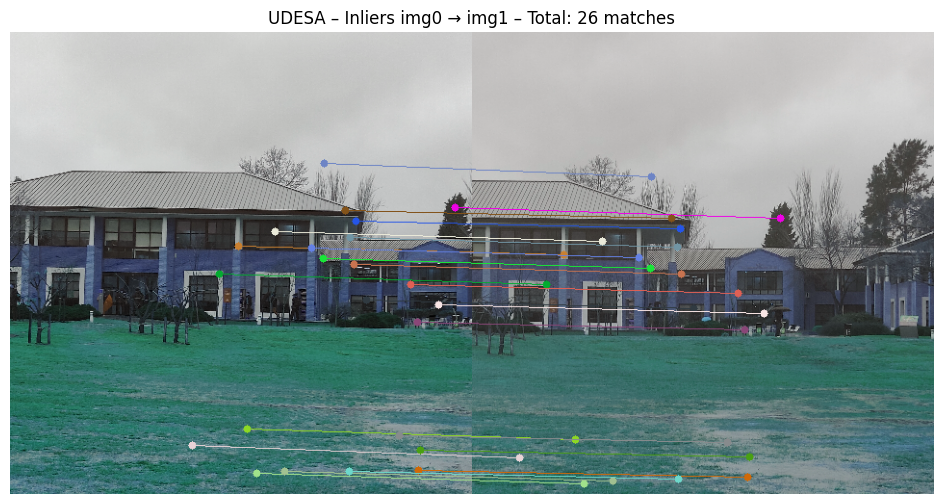

Matriz de homografía H – UDESA:
[[ 9.52328349e-01 -1.96055495e-02 -1.25012257e+02]
 [-1.68696473e-02  9.11984634e-01  2.89617008e+01]
 [ 2.10189017e-06 -1.24923193e-04  1.00000000e+00]]


In [89]:


# Obtener puntos de los keypoints según los matches
pts0 = np.float32([kp0_udesa[m.queryIdx].pt for m in matches_01_udesa])
pts1 = np.float32([kp1_udesa[m.trainIdx].pt for m in matches_01_udesa])

# Estimar homografía usando RANSAC (tu implementación)
H_udesa, inlier_mask_udesa = ransac_homography(pts0, pts1, num_iters=2000, threshold=5.0)

# Filtrar los matches inliers
inlier_matches_01_udesa = [m for m, keep in zip(matches_01_udesa, inlier_mask_udesa) if keep]

# Visualizar matches inliers
img_matches_01_udesa = draw_matches_ransac(img0_udesa, kp0_udesa, img1_udesa, kp1_udesa, inlier_matches_01_udesa)

plt.figure(figsize=(12, 6))
plt.imshow(img_matches_01_udesa)
plt.axis('off')
plt.title(f"UDESA – Inliers img0 → img1 – Total: {len(inlier_matches_01_udesa)} matches")
plt.show()

print("Matriz de homografía H – UDESA:")
print(H_udesa)


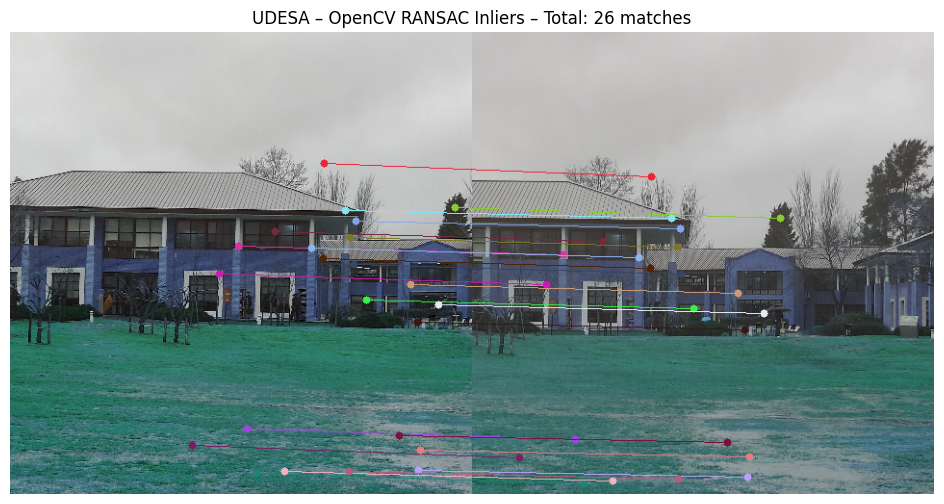

Matriz de homografía H (OpenCV - UDESA):
[[ 1.02978188e+00  3.35397401e-04 -1.46975624e+02]
 [ 1.69037274e-02  9.91940009e-01  1.00171871e+01]
 [ 8.57406270e-05 -4.93301683e-05  1.00000000e+00]]


In [93]:
# === RANSAC con OpenCV para UDESA ===

# Obtener puntos (mismo proceso que para tu RANSAC)
pts0_cv = np.float32([kp0_udesa[m.queryIdx].pt for m in matches_01_udesa])
pts1_cv = np.float32([kp1_udesa[m.trainIdx].pt for m in matches_01_udesa])

# Usar OpenCV para estimar homografía con RANSAC
H_cv_udesa, mask_cv_udesa = cv2.findHomography(pts0_cv, pts1_cv, cv2.RANSAC, ransacReprojThreshold=5.0)

# Filtrar matches válidos (inliers)
inlier_matches_cv_udesa = [m for m, keep in zip(matches_01_udesa, mask_cv_udesa.ravel()) if keep]

# Dibujar matches con los inliers de OpenCV
img_matches_cv_udesa = draw_matches_ransac(img0_udesa, kp0_udesa, img1_udesa, kp1_udesa, inlier_matches_cv_udesa)

# Visualización
plt.figure(figsize=(12, 6))
plt.imshow(img_matches_cv_udesa)
plt.axis('off')
plt.title(f"UDESA – OpenCV RANSAC Inliers – Total: {len(inlier_matches_cv_udesa)} matches")
plt.show()

print("Matriz de homografía H (OpenCV - UDESA):")
print(H_cv_udesa)


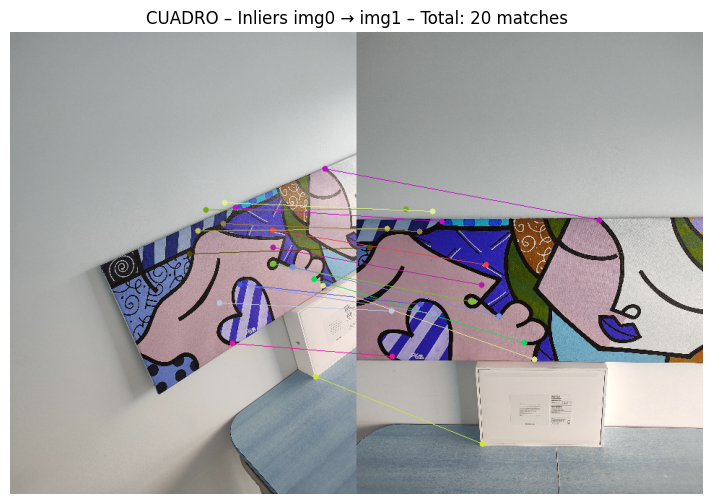

Matriz de homografía H – CUADRO:
[[ 1.06486849e+00 -3.12025109e-01 -1.51278936e+02]
 [ 2.12373074e-01  1.03855874e+00 -9.25385921e+01]
 [-7.17603419e-04  3.51809100e-04  1.00000000e+00]]


In [91]:
# === RANSAC para CUADRO ===
# Obtener puntos de los keypoints según los matches
pts0 = np.float32([kp0_cuadro[m.queryIdx].pt for m in matches_01_cuadro])
pts1 = np.float32([kp1_cuadro[m.trainIdx].pt for m in matches_01_cuadro])

# Estimar homografía usando RANSAC (tu implementación)
H_cuadro, inlier_mask_cuadro = ransac_homography(pts0, pts1, num_iters=2000, threshold=5.0)

# Filtrar los matches inliers
inlier_matches_01_cuadro = [m for m, keep in zip(matches_01_cuadro, inlier_mask_cuadro) if keep]

# Visualizar matches inliers
img_matches_01_cuadro = draw_matches_ransac(img0_cuadro, kp0_cuadro, img1_cuadro, kp1_cuadro, inlier_matches_01_cuadro)

plt.figure(figsize=(12, 6))
plt.imshow(img_matches_01_cuadro)
plt.axis('off')
plt.title(f"CUADRO – Inliers img0 → img1 – Total: {len(inlier_matches_01_cuadro)} matches")
plt.show()

print("Matriz de homografía H – CUADRO:")
print(H_cuadro)


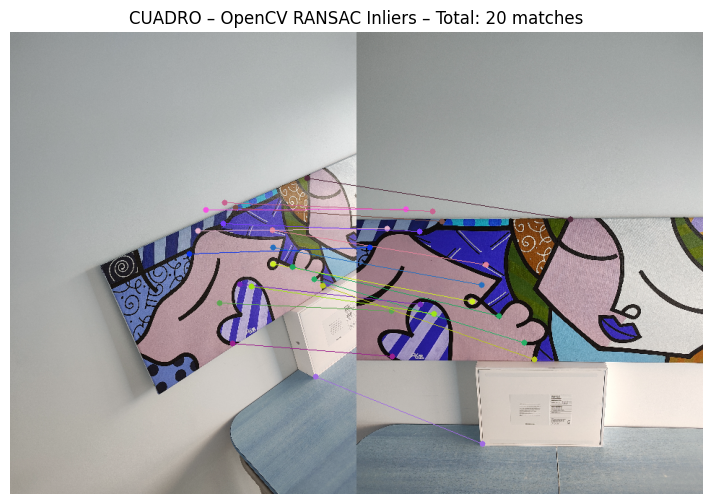

Matriz de homografía H (OpenCV - CUADRO):
[[ 1.04461857e+00 -2.80060862e-01 -1.55030040e+02]
 [ 1.60048169e-01  1.11466718e+00 -9.92524458e+01]
 [-8.99247284e-04  5.44241108e-04  1.00000000e+00]]


In [94]:
# === RANSAC con OpenCV para CUADRO ===

# Obtener puntos desde los keypoints y matches
pts0_cv_cuadro = np.float32([kp0_cuadro[m.queryIdx].pt for m in matches_01_cuadro])
pts1_cv_cuadro = np.float32([kp1_cuadro[m.trainIdx].pt for m in matches_01_cuadro])

# Estimar homografía usando RANSAC de OpenCV
H_cv_cuadro, mask_cv_cuadro = cv2.findHomography(pts0_cv_cuadro, pts1_cv_cuadro, cv2.RANSAC, ransacReprojThreshold=5.0)

# Filtrar matches válidos
inlier_matches_cv_cuadro = [m for m, keep in zip(matches_01_cuadro, mask_cv_cuadro.ravel()) if keep]

# Dibujar los matches con los inliers
img_matches_cv_cuadro = draw_matches_ransac(img0_cuadro, kp0_cuadro, img1_cuadro, kp1_cuadro, inlier_matches_cv_cuadro)

# Mostrar resultados
plt.figure(figsize=(12, 6))
plt.imshow(img_matches_cv_cuadro)
plt.axis('off')
plt.title(f"CUADRO – OpenCV RANSAC Inliers – Total: {len(inlier_matches_cv_cuadro)} matches")
plt.show()

print("Matriz de homografía H (OpenCV - CUADRO):")
print(H_cv_cuadro)


## Juntamos todo para obtener las panoramicas

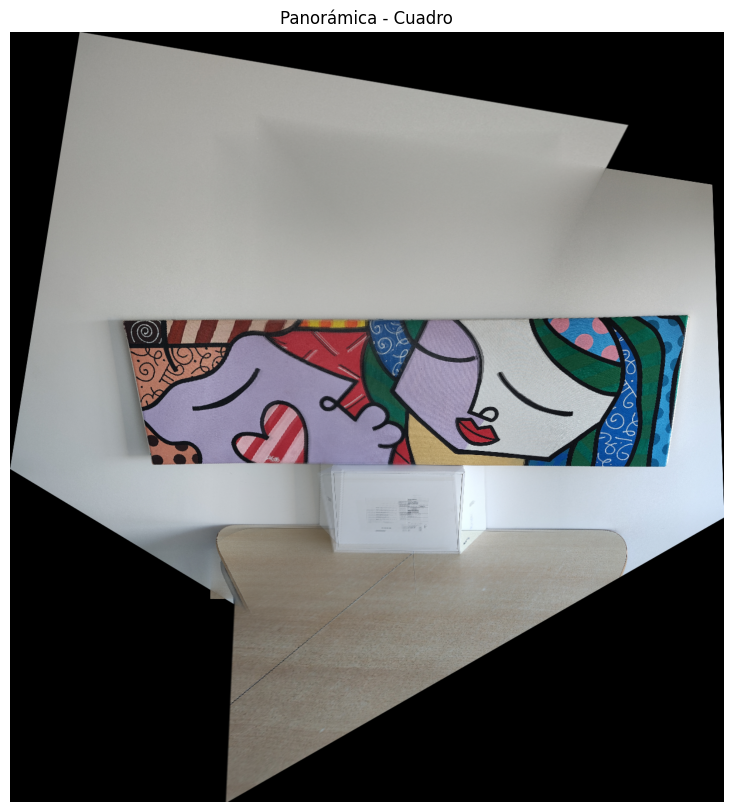

True

In [115]:


# Cargar solo imágenes de cuadro
folder = "img/"
img_files = sorted([f for f in os.listdir(folder) if "cuadro" in f and f.endswith(".jpg")])
img_paths = [os.path.join(folder, f) for f in img_files]

imgs_color = [cv2.imread(path) for path in img_paths]
imgs_color = [cv2.resize(img, (600, int(img.shape[0] * 600 / img.shape[1]))) for img in imgs_color]
imgs_gray = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in imgs_color]

img0, img1, img2 = imgs_color[0], imgs_color[1], imgs_color[2]
gray0, gray1, gray2 = imgs_gray[0], imgs_gray[1], imgs_gray[2]

kp0, desc0 = anms(*detect_features(gray0), N=200)
kp1, desc1 = anms(*detect_features(gray1), N=200)
kp2, desc2 = anms(*detect_features(gray2), N=200)

matches01 = match_descriptors(desc0, desc1, method="lowe")
matches21 = match_descriptors(desc2, desc1, method="lowe")

pts0 = np.float32([kp0[m.queryIdx].pt for m in matches01])
pts1_0 = np.float32([kp1[m.trainIdx].pt for m in matches01])
pts2 = np.float32([kp2[m.queryIdx].pt for m in matches21])
pts1_2 = np.float32([kp1[m.trainIdx].pt for m in matches21])

H01, _ = ransac_homography(pts0, pts1_0)
H12, _ = ransac_homography(pts2, pts1_2)

panorama_cuadro = stitch_images_with_blending(img0, img1, img2, H01, H12)

plt.figure(figsize=(20, 10))
plt.imshow(cv2.cvtColor(panorama_cuadro, cv2.COLOR_BGR2RGB))
plt.title("Panorámica - Cuadro")
plt.axis("off")
plt.show()

cv2.imwrite("panorama_cuadro.jpg", panorama_cuadro)


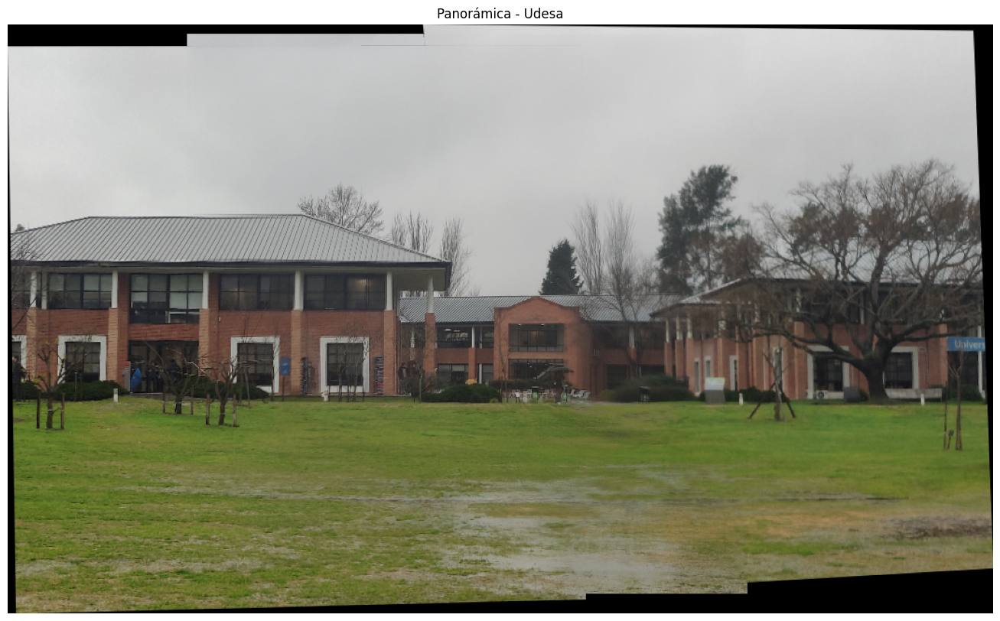

True

In [116]:
# Cargar solo imágenes de udesa
img_files = sorted([f for f in os.listdir(folder) if "udesa" in f and f.endswith(".jpg")])
img_paths = [os.path.join(folder, f) for f in img_files]

imgs_color = [cv2.imread(path) for path in img_paths]
imgs_color = [cv2.resize(img, (600, int(img.shape[0] * 600 / img.shape[1]))) for img in imgs_color]
imgs_gray = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in imgs_color]

img0, img1, img2 = imgs_color[0], imgs_color[1], imgs_color[2]
gray0, gray1, gray2 = imgs_gray[0], imgs_gray[1], imgs_gray[2]

kp0, desc0 = anms(*detect_features(gray0), N=200)
kp1, desc1 = anms(*detect_features(gray1), N=200)
kp2, desc2 = anms(*detect_features(gray2), N=200)

matches01 = match_descriptors(desc0, desc1, method="lowe")
matches21 = match_descriptors(desc2, desc1, method="lowe")

pts0 = np.float32([kp0[m.queryIdx].pt for m in matches01])
pts1_0 = np.float32([kp1[m.trainIdx].pt for m in matches01])
pts2 = np.float32([kp2[m.queryIdx].pt for m in matches21])
pts1_2 = np.float32([kp1[m.trainIdx].pt for m in matches21])

H01, _ = ransac_homography(pts0, pts1_0)
H12, _ = ransac_homography(pts2, pts1_2)

panorama_udesa = stitch_images_with_blending(img0, img1, img2, H01, H12)

plt.figure(figsize=(20, 10))
plt.imshow(cv2.cvtColor(panorama_udesa, cv2.COLOR_BGR2RGB))
plt.title("Panorámica - Udesa")
plt.axis("off")
plt.show()

cv2.imwrite("panorama_udesa.jpg", panorama_udesa)
